# Importing Libraries

In [1]:
import numpy as np
import pandas as pd
from PIL import Image
import os 
import random
import subprocess
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle
from numpy import asarray
import tensorflow as tf
from tensorflow.keras import layers, models, Input, Model
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import BinaryCrossentropy
from tensorflow import keras
from tensorflow.keras import Sequential
from tensorflow.keras.layers import Dense ,GlobalAveragePooling2D
import warnings
warnings.filterwarnings("ignore")

# Loading Dataset

In [2]:
print(f'The version of Tensorflow  is  : {tf.__version__}')

The version of Tensorflow  is  : 2.16.1


In [3]:
import tensorflow as tf
print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))


Num GPUs Available:  1


In [4]:
print('GPU is using') if len(tf.config.list_physical_devices('GPU')) == 1 else print('CPU is using')

GPU is using


In [5]:
directory = "/kaggle/input/revitsone-5classes/Revitsone-5classes/"
folders = ["other_activities" , "safe_driving" , "talking_phone" , "texting_phone" , "turning"]
other_activities_img = []
safe_driving_img = []
talking_phone_img = []
texting_phone_img = []
turning_img = []
for imgother in os.listdir(directory + folders[0]):
     if imgother.endswith(".jpg") or imgother.endswith(".png"): 
            other_activities_img.append(os.path.join("/kaggle/input/revitsone-5classes/Revitsone-5classes/other_activities",imgother))
            
for imgsafe in os.listdir(directory + folders[1]):
     if imgsafe.endswith(".jpg") or imgsafe.endswith(".png"): 
            safe_driving_img.append(os.path.join("/kaggle/input/revitsone-5classes/Revitsone-5classes/safe_driving",imgsafe))
            
for imgtalk in os.listdir(directory + folders[2]):
     if imgtalk.endswith(".jpg") or imgtalk.endswith(".png"): 
            talking_phone_img.append(os.path.join("/kaggle/input/revitsone-5classes/Revitsone-5classes/talking_phone",imgtalk))
            
for imgtext in os.listdir(directory + folders[3]):
     if imgtext.endswith(".jpg") or imgtext.endswith(".png"): 
            texting_phone_img.append(os.path.join("/kaggle/input/revitsone-5classes/Revitsone-5classes/texting_phone",imgtext))
            
for imgturn in os.listdir(directory + folders[4]):
     if imgturn.endswith(".jpg") or imgturn.endswith(".png"): 
            turning_img.append(os.path.join("/kaggle/input/revitsone-5classes/Revitsone-5classes/turning",imgturn))
    

# JPG & PNG formats

In [6]:
def detect_JPG_PNG(path , name):
    JPG = []
    PNG = []
    for img in path : 
        
            if img.split('.')[1] == 'jpg':
                JPG.append(img)
            else:
                PNG.append(img)
                
    print(f'The folder name is : {name}')
    print(f'The number of all images : {len(path)}')
    print(f'The number of images with jpg format is : {len(JPG)}')
    print(f'The number of images with png format is : {len(PNG)}')

In [7]:
detect_JPG_PNG(path = other_activities_img, name='other activities')


The folder name is : other activities
The number of all images : 2119
The number of images with jpg format is : 2059
The number of images with png format is : 60


In [8]:
detect_JPG_PNG(path = safe_driving_img, name='safe_driving')

The folder name is : safe_driving
The number of all images : 2203
The number of images with jpg format is : 2179
The number of images with png format is : 24


In [9]:
detect_JPG_PNG(path = talking_phone_img  , name = 'talking_phone')

The folder name is : talking_phone
The number of all images : 2169
The number of images with jpg format is : 2145
The number of images with png format is : 24


In [10]:
detect_JPG_PNG(path = texting_phone_img , name = 'texting')

The folder name is : texting
The number of all images : 2203
The number of images with jpg format is : 2189
The number of images with png format is : 14


In [11]:
detect_JPG_PNG(path = turning_img  , name = 'turning')

The folder name is : turning
The number of all images : 2057
The number of images with jpg format is : 1996
The number of images with png format is : 61


# Image illustration

In [12]:
def show_images(path , seed , kind ):
    random.seed(seed)
    Random_Image_Path = random.choices(path , k=6)
    plt.style.use('dark_background')
    plt.figure(figsize=(13 ,10))
    plt.suptitle(kind  , fontsize=15 ,fontstyle='italic' , c='black' , backgroundcolor = 'white' )
    for i, images in enumerate(Random_Image_Path):
        plt.subplot(3,2,i+1)
        img = Image.open(images)
#         plt.axis('off')
        plt.title(f'size : ({img.width} ,{img.height} )')
        plt.imshow(img)

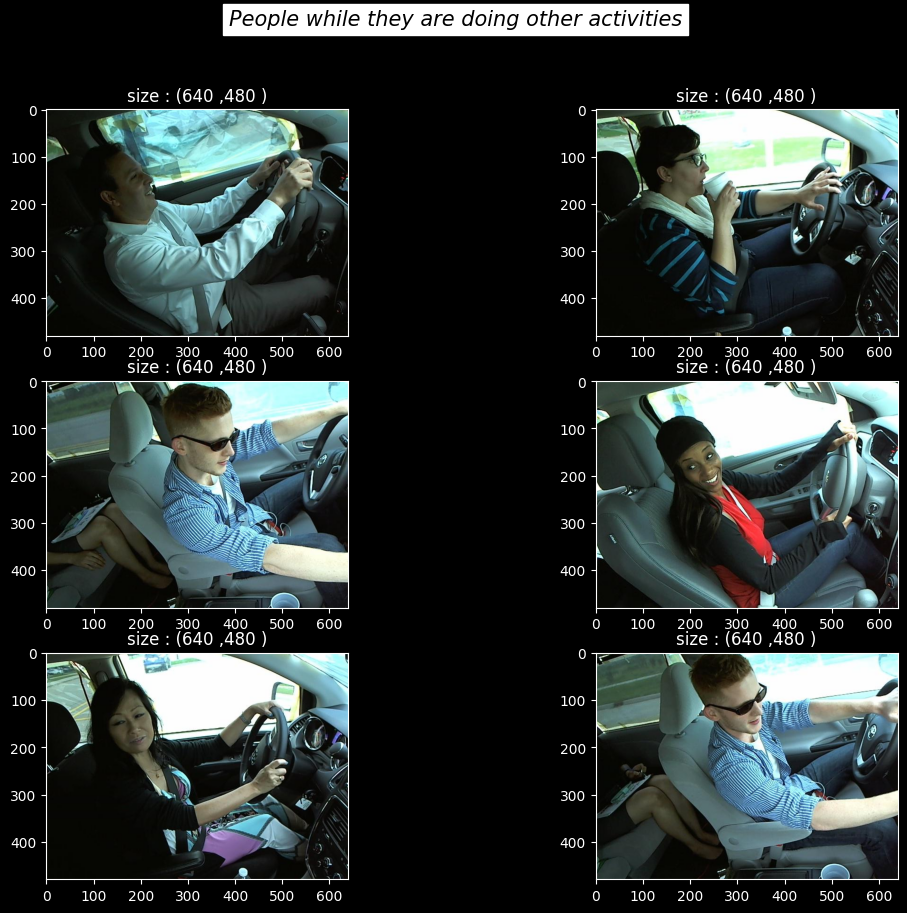

In [13]:
show_images(path = other_activities_img , seed = 42 , kind='People while they are doing other activities' )

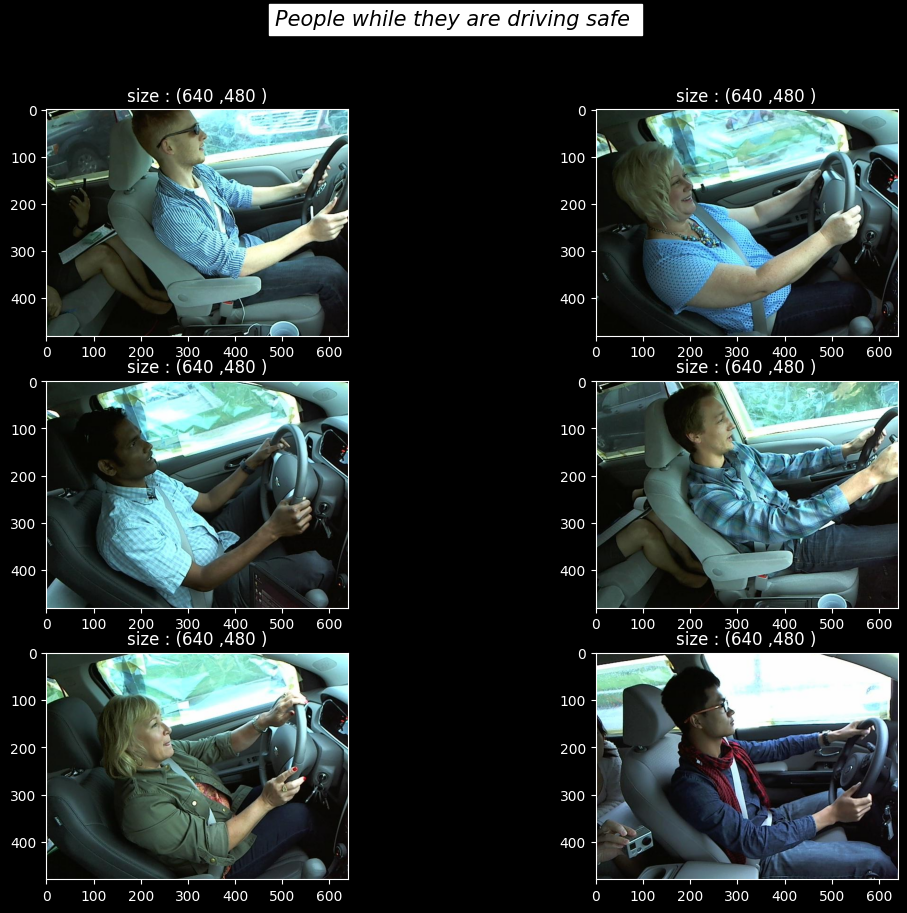

In [14]:
show_images(path = safe_driving_img , seed = 42 , kind='People while they are driving safe ' )

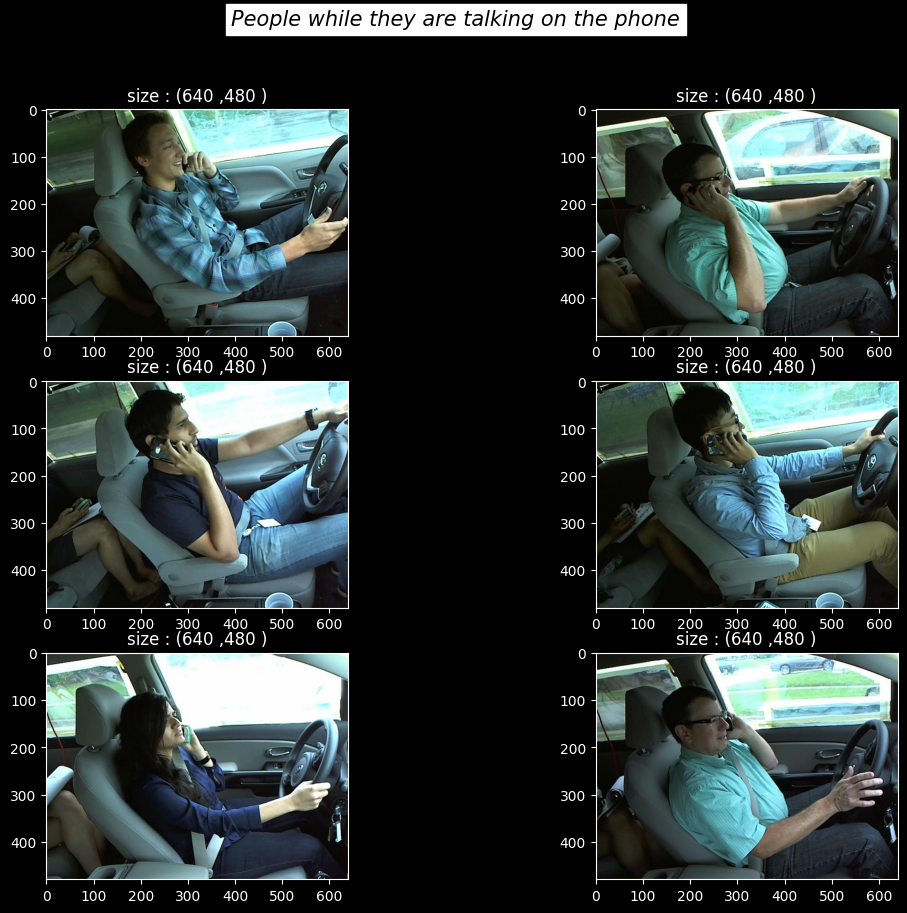

In [15]:
show_images(path = talking_phone_img , seed = 42 , kind='People while they are talking on the phone' )

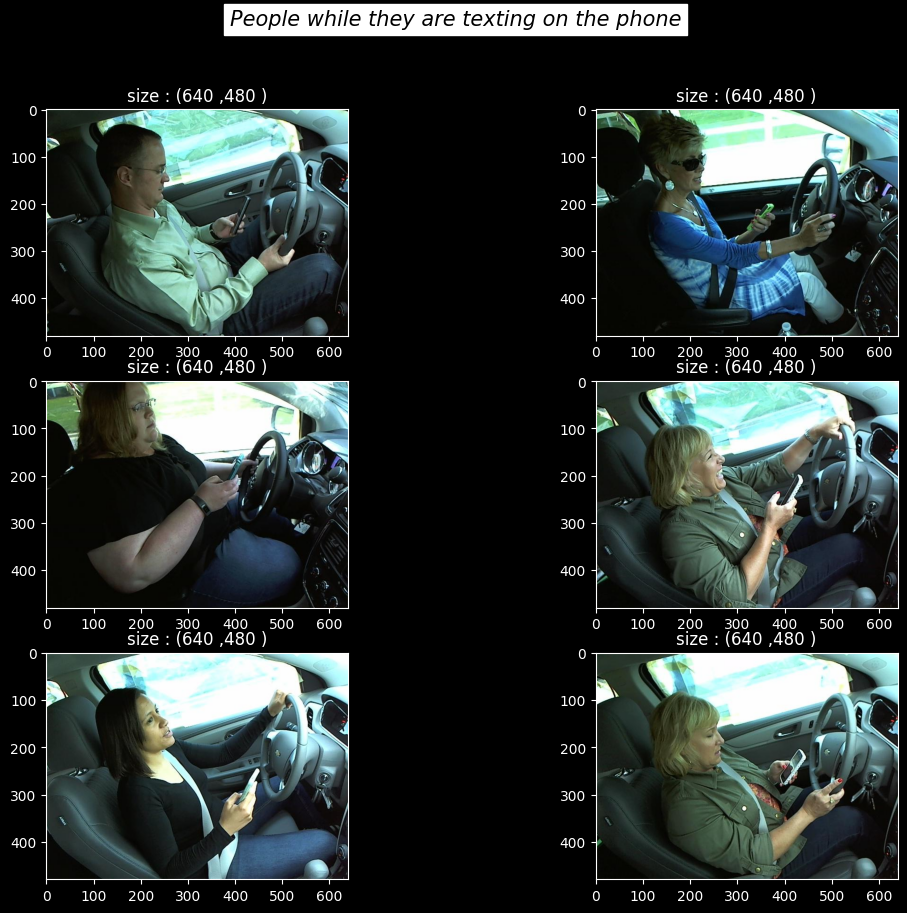

In [16]:
show_images(path = texting_phone_img , seed = 42 , kind='People while they are texting on the phone' )

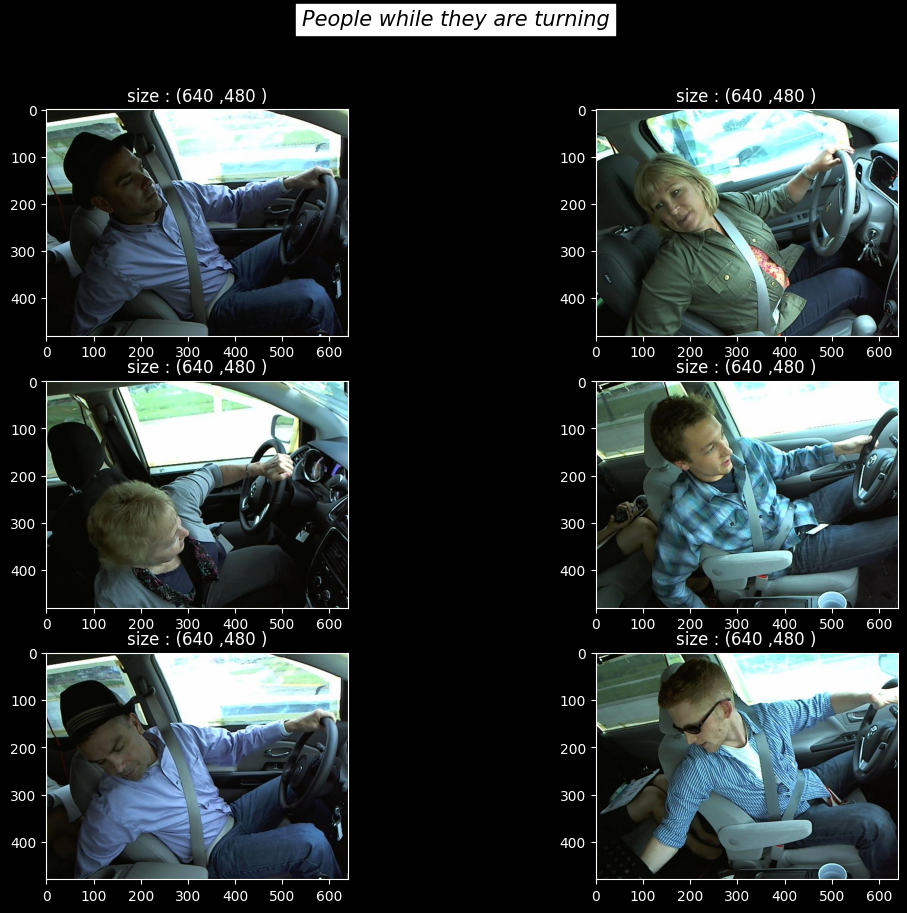

In [17]:
show_images(path = turning_img , seed = 42 , kind='People while they are turning' )

# Train, Test, Validate

In [18]:
train_other_activities  ,  test_other_activities   , valid_other_activities= [] , [] ,[]


train_drive_safe ,  test_drive_safe  , valid_drive_safe = [] , [] ,[]


train_talking  ,  test_talking   , valid_talking = [] , [] , []


train_texting  ,  test_texting   , valid_texting= [] , [] ,[]

 
train_turning  ,  test_turning   , valid_turning= [] , [] ,[]

def train_test_validation(data , Train , Test , Valid , Name ):
    
    Len = len(data)
    train_num = int( Len * 0.85)
    test_num = int(Len * 0.10)
    valid_num = int(Len * 0.05)
    
    n_t = train_num + test_num
    Train.extend(data[:train_num])
    Test.extend(data[train_num : n_t])
    Valid.extend(data[n_t :])
   

 

    print(f'Name : {Name}')
    print(f'Number of all images : {Len}')
    print(f'Train(85%) : {len(Train)}')
    print(f'Test(10%) :{len(Test)}')
    print(f'Valid(5%) : {len(Valid)}')


In [19]:
train_test_validation(data = other_activities_img , Train=train_other_activities , Test=test_other_activities , Valid=valid_other_activities , Name='Other_activities')

Name : Other_activities
Number of all images : 2119
Train(85%) : 1801
Test(10%) :211
Valid(5%) : 107


In [20]:
train_test_validation(data = safe_driving_img , Train=train_drive_safe , Test=test_drive_safe , Valid=valid_drive_safe , Name='Driving safe')

Name : Driving safe
Number of all images : 2203
Train(85%) : 1872
Test(10%) :220
Valid(5%) : 111


In [21]:
train_test_validation(data = talking_phone_img, Train=train_talking , Test=test_talking , Valid=valid_talking, Name='Talking on the phone')

Name : Talking on the phone
Number of all images : 2169
Train(85%) : 1843
Test(10%) :216
Valid(5%) : 110


In [22]:
train_test_validation(data = texting_phone_img , Train=train_texting , Test=test_texting , Valid=valid_texting , Name='Texting on the phone')

Name : Texting on the phone
Number of all images : 2203
Train(85%) : 1872
Test(10%) :220
Valid(5%) : 111


In [23]:
train_test_validation(data = turning_img , Train=train_turning , Test=test_turning , Valid=valid_turning , Name='Turning')

Name : Turning
Number of all images : 2057
Train(85%) : 1748
Test(10%) :205
Valid(5%) : 104


In [24]:
Train_Other_DataFrame = pd.DataFrame({'Img' : train_other_activities , 'Label' : 'Other activities'})
Train_Drive_Safe_DataFrame = pd.DataFrame({'Img' : train_drive_safe , 'Label' : 'Drive safe'})
Train_Talking_DataFrame = pd.DataFrame({'Img' : train_talking , 'Label' : 'Talking'})
Train_Texting_DataFrame = pd.DataFrame({'Img' : train_texting , 'Label' : 'Texting'})
Train_Turning_DataFrame = pd.DataFrame({'Img' : train_turning , 'Label' : 'Turning'})

#--------------------------------------------------------Train DF

Test_Other_DataFrame = pd.DataFrame({'Img' : test_other_activities , 'Label' : 'Other activities'})
Test_Drive_Safe_DataFrame = pd.DataFrame({'Img' : test_drive_safe , 'Label' : 'Drive safe'})
Test_Talking_DataFrame = pd.DataFrame({'Img' : test_talking , 'Label' : 'Talking'})
Test_Texting_DataFrame = pd.DataFrame({'Img' : test_texting , 'Label' : 'Texting'})
Test_Turning_DataFrame = pd.DataFrame({'Img' : test_turning ,  'Label' : 'Turning'})

#---------------------------------------------------------Test DF

Valid_Other_DataFrame = pd.DataFrame({'Img' : valid_other_activities , 'Label' : 'Other activities'})
Valid_Drive_Safe_DataFrame = pd.DataFrame({'Img' : valid_drive_safe , 'Label' : 'Drive safe'})
Valid_Talking_DataFrame = pd.DataFrame({'Img' : valid_talking , 'Label' : 'Talking'})
Valid_Texting_DataFrame = pd.DataFrame({'Img' : valid_texting , 'Label' : 'Texting'})
Valid_Turning_DataFrame = pd.DataFrame({'Img' : valid_turning , 'Label' : 'Turning'})

#-----------------------------------------------------------Valid DF

In [25]:
Train_df_all = pd.concat([Train_Other_DataFrame , Train_Drive_Safe_DataFrame , Train_Talking_DataFrame , Train_Texting_DataFrame , Train_Turning_DataFrame])
Test_df_all = pd.concat([Test_Other_DataFrame , Test_Drive_Safe_DataFrame , Test_Talking_DataFrame , Test_Texting_DataFrame , Test_Turning_DataFrame])
Valid_df_all = pd.concat([Valid_Other_DataFrame , Valid_Drive_Safe_DataFrame , Valid_Talking_DataFrame , Valid_Texting_DataFrame , Valid_Turning_DataFrame])

In [26]:
print(f'The shape of Train DataFrame is : {Train_df_all.shape}')
print(f'The shape of Test DataFrame is : {Test_df_all.shape}')
print(f'The shape of Valid DataFrame is : {Valid_df_all.shape}')

The shape of Train DataFrame is : (9136, 2)
The shape of Test DataFrame is : (1072, 2)
The shape of Valid DataFrame is : (543, 2)


In [27]:
Driver_behaviour_classes = ['Drive safe' , 'Other activities' ,   'Talking' , 'Texting' ,'Turning']

In [28]:
Driver_behaviour_classes

['Drive safe', 'Other activities', 'Talking', 'Texting', 'Turning']

In [29]:
Train_df_all

,Img,Label
0,/kaggle/input/revitsone-5classes/Revitsone-5cl...,Other activities
1,/kaggle/input/revitsone-5classes/Revitsone-5cl...,Other activities
2,/kaggle/input/revitsone-5classes/Revitsone-5cl...,Other activities
3,/kaggle/input/revitsone-5classes/Revitsone-5cl...,Other activities
4,/kaggle/input/revitsone-5classes/Revitsone-5cl...,Other activities
...,...,...
1743,/kaggle/input/revitsone-5classes/Revitsone-5cl...,Turning
1744,/kaggle/input/revitsone-5classes/Revitsone-5cl...,Turning
1745,/kaggle/input/revitsone-5classes/Revitsone-5cl...,Turning
1746,/kaggle/input/revitsone-5classes/Revitsone-5cl...,Turning


# Image Processing

In [30]:
Train_Image_Data_Generator = ImageDataGenerator(rescale=1./255.)
Test_Image_Data_Generator = ImageDataGenerator(rescale=1./255.)
Valid_Image_Data_Generator = ImageDataGenerator(rescale=1./255.)

In [31]:
num_classes = 5 
bach_size = 64
img_size = 240 

In [32]:
Train_loader = Train_Image_Data_Generator.flow_from_dataframe(
    dataframe=Train_df_all , 
    class_mode='categorical' , 
    x_col='Img' , 
    y_col='Label',
    batch_size=bach_size ,
    seed=42 , 
    shuffle=True , 
    target_size =(img_size , img_size)
)


Test_loader =Test_Image_Data_Generator.flow_from_dataframe(
    dataframe=Test_df_all , 
    class_mode='categorical' , 
    x_col='Img' , 
    y_col='Label',
    batch_size=bach_size ,
    seed=42 , 
    shuffle=True , #also can be False , No difference in result 
    target_size =(img_size , img_size)
)



Valid_loader =Valid_Image_Data_Generator.flow_from_dataframe(
    dataframe=Valid_df_all , 
    class_mode='categorical' , 
    x_col='Img' , 
    y_col='Label',
    batch_size=bach_size ,
    seed=42 , 
    shuffle=True , 
    target_size =(img_size , img_size)
)

Found 9136 validated image filenames belonging to 5 classes.
Found 1072 validated image filenames belonging to 5 classes.
Found 543 validated image filenames belonging to 5 classes.


In [33]:

def show_accuracy(Train_acc , Val_acc , epoch_num , model):
    plt.style.use('dark_background')
    plt.figure(figsize=(10 , 5))
    plt.plot(epoch_num, Train_acc, '--bo', color= 'white')
    plt.plot(epoch_num, Val_acc, '--bo',color= 'blue', linewidth = '2.5', label='line with marker')
    plt.legend(['Training Acc', 'Val Acc'])
    plt.title(f'Train & Val Accuracy in {model}')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.xticks(np.arange(1,7,1))
    plt.show()
    
def show_loss(Train_loss , Val_loss , epoch_num , model):
    plt.style.use('dark_background')
    plt.figure(figsize=(10 , 5))
    plt.plot(epoch_num, Train_loss, '--bo',linewidth = '1.5', color= 'white')
    plt.plot(epoch_num, Val_loss, '--bo',color= 'blue', linewidth = '1.5', label='line with marker')
    plt.legend(['Training Loss', 'Val Loss'])
    plt.title(f'Train & Val Loss in {model}')
    plt.xlabel('Epoch' , c='b')
    plt.ylabel('Accuracy', c='b')
    plt.xticks(np.arange(1,7,1))
    plt.show()

# VGG16

In [34]:
VGG = keras.applications.vgg16.VGG16(include_top=False , weights='imagenet')
x=VGG.output
x = GlobalAveragePooling2D()(x)
x = Dense(1024 , activation='relu')(x)
prediction = Dense(5 , activation='softmax')(x)
Model_VGG16 = Model(inputs = VGG.inputs , outputs =prediction)
Model_VGG16.summary()

58889256/58889256 ━━━━━━━━━━━━━━━━━━━━ 2s 0us/step


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, None, None, 3)  │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv1 (Conv2D)           │ (None, None, None, 64) │         1,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv2 (Conv2D)           │ (None, None, None, 64) │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_pool (MaxPooling2D)      │ (None, None, None, 64) │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv1 (Conv2D)           │ (None, None, None,     │        73,856 │
│                                 │ 128)                   │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv2 (Conv2D)           │ (None, None, None,     │       147,584 │
│                                 │ 128)                   │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_pool (MaxPooling2D)      │ (None, None, None,     │             0 │
│                                 │ 128)                   │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv1 (Conv2D)           │ (None, None, None,     │       295,168 │
│                                 │ 256)                   │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv2 (Conv2D)           │ (None, None, None,     │       590,080 │
│                                 │ 256)                   │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv3 (Conv2D)           │ (None, None, None,     │       590,080 │
│                                 │ 256)                   │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_pool (MaxPooling2D)      │ (None, None, None,     │             0 │
│                                 │ 256)                   │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv1 (Conv2D)           │ (None, None, None,     │     1,180,160 │
│                                 │ 512)                   │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv2 (Conv2D)           │ (None, None, None,     │     2,359,808 │
│                                 │ 512)                   │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv3 (Conv2D)           │ (None, None, None,     │     2,359,808 │
│                                 │ 512)                   │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_pool (MaxPooling2D)      │ (None, None, None,     │             0 │
│                                 │ 512)                   │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv1 (Conv2D)           │ (None, None, None,     │     2,359,808 │
│                                 │ 512)                   │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv2 (Conv2D)           │ (None, None, None,     │     2,359,808 │
│                                 │ 512)                   │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv3 (Conv2D)           │ (None, None, None,     │     2,359,808 │
│                                 │ 512)                   │             

 Total params: 15,245,125 (58.16 MB)

 Trainable params: 15,245,125 (58.16 MB)

 Non-trainable params: 0 (0.00 B)

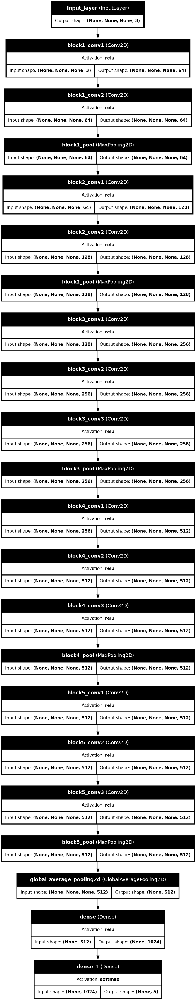

In [35]:
tf.keras.utils.plot_model(
    Model_VGG16,
    to_file='vgg_model.png',
    show_shapes=True,
    show_dtype=False,
    show_layer_names=True,
    show_layer_activations=True,
    dpi=80
)

In [36]:
Model_VGG16.compile(loss=BinaryCrossentropy(),
              optimizer=Adam(learning_rate=0.001), metrics=['accuracy'])

In [37]:
VGG16_model = Model_VGG16.fit(Train_loader, epochs=6, validation_data=Valid_loader)

Epoch 1/6


I0000 00:00:1732690331.316234      76 service.cc:145] XLA service 0x7d24f40020d0 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1732690331.316315      76 service.cc:153]   StreamExecutor device (0): Tesla P100-PCIE-16GB, Compute Capability 6.0
I0000 00:00:1732690371.310501      76 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


143/143 ━━━━━━━━━━━━━━━━━━━━ 149s 718ms/step - accuracy: 0.1963 - loss: 1.5793 - val_accuracy: 0.2155 - val_loss: 0.5001
Epoch 2/6
143/143 ━━━━━━━━━━━━━━━━━━━━ 65s 443ms/step - accuracy: 0.2031 - loss: 0.5021 - val_accuracy: 0.1971 - val_loss: 0.5052
Epoch 3/6
143/143 ━━━━━━━━━━━━━━━━━━━━ 65s 443ms/step - accuracy: 0.2007 - loss: 0.5043 - val_accuracy: 0.1915 - val_loss: 0.5071
Epoch 4/6
143/143 ━━━━━━━━━━━━━━━━━━━━ 65s 443ms/step - accuracy: 0.2010 - loss: 0.5031 - val_accuracy: 0.1915 - val_loss: 0.5012
Epoch 5/6
143/143 ━━━━━━━━━━━━━━━━━━━━ 65s 442ms/step - accuracy: 0.2103 - loss: 0.4991 - val_accuracy: 0.2947 - val_loss: 0.4814
Epoch 6/6
143/143 ━━━━━━━━━━━━━━━━━━━━ 65s 441ms/step - accuracy: 0.3568 - loss: 0.4513 - val_accuracy: 0.4549 - val_loss: 0.3912


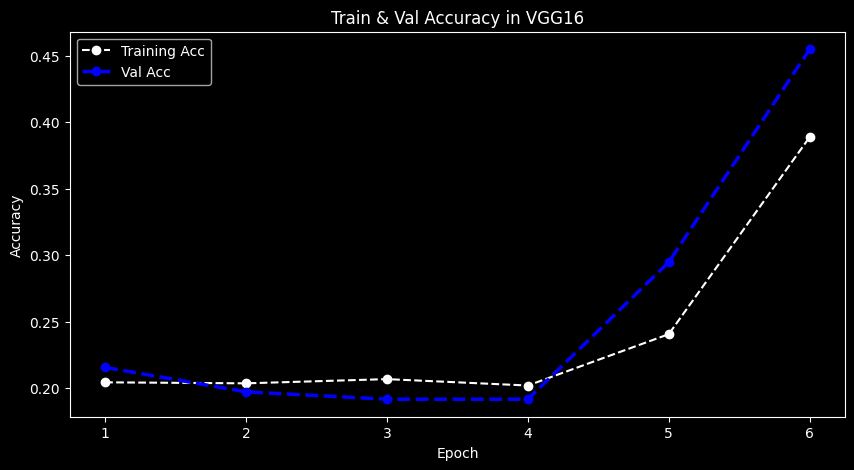

In [38]:
show_accuracy(Train_acc=VGG16_model.history['accuracy'] , Val_acc=VGG16_model.history['val_accuracy'] , epoch_num= range(1,7,1) , model='VGG16')

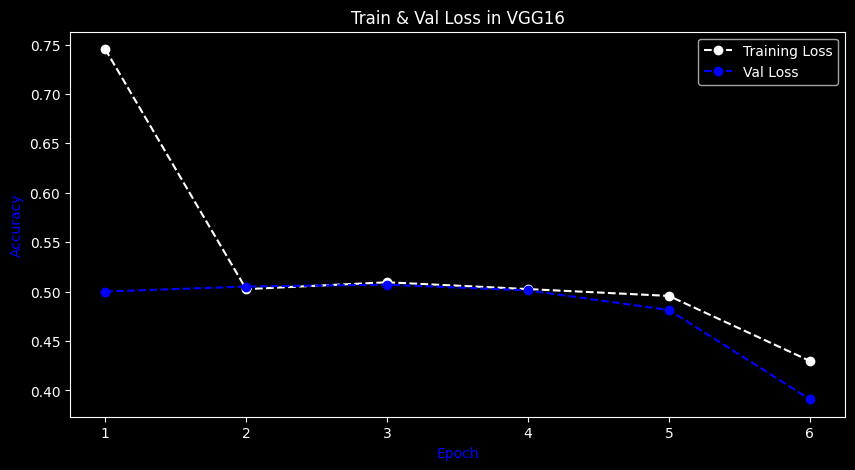

In [39]:
show_loss(Train_loss=VGG16_model.history['loss'] , Val_loss=VGG16_model.history['val_loss'] , epoch_num=range(1,7,1) , model='VGG16')

In [40]:
Model_VGG16.evaluate(Test_loader)#Evaluate the model 


17/17 ━━━━━━━━━━━━━━━━━━━━ 6s 374ms/step - accuracy: 0.4506 - loss: 0.3967


[0.3939867913722992, 0.45615673065185547]

In [41]:
Model_VGG16.save('VGG16.h5')#saving the Xception model

# ResNet50

In [42]:
Resnet50 = keras.applications.resnet50.ResNet50(include_top=False , weights='imagenet')
X=Resnet50.output
X=GlobalAveragePooling2D()(X)
X=Dense(1024 , activation='relu')(X)
Xprediction = Dense(5 , activation='softmax')(X)
Model_Resnet50 = Model(inputs = Resnet50.inputs , outputs = Xprediction)
Model_Resnet50.summary()

94765736/94765736 ━━━━━━━━━━━━━━━━━━━━ 3s 0us/step


Model: "functional_3"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_1       │ (None, None,      │          0 │ -                 │
│ (InputLayer)        │ None, 3)          │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_pad           │ (None, None,      │          0 │ input_layer_1[0]… │
│ (ZeroPadding2D)     │ None, 3)          │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_conv (Conv2D) │ (None, None,      │      9,472 │ conv1_pad[0][0]   │
│                     │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_bn            │ (None, None,      │        256 │ conv1_conv[0][0]  │
│ (BatchNormalizatio… │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_relu          │ (None, None,      │          0 │ conv1_bn[0][0]    │
│ (Activation)        │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1_pad           │ (None, None,      │          0 │ conv1_relu[0][0]  │
│ (ZeroPadding2D)     │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1_pool          │ (None, None,      │          0 │ pool1_pad[0][0]   │
│ (MaxPooling2D)      │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_conv │ (None, None,      │      4,160 │ pool1_pool[0][0]  │
│ (Conv2D)            │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_bn   │ (None, None,      │        256 │ conv2_block1_1_c… │
│ (BatchNormalizatio… │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_relu │ (None, None,      │          0 │ conv2_block1_1_b… │
│ (Activation)        │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_conv │ (None, None,      │     36,928 │ conv2_block1_1_r… │
│ (Conv2D)            │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_bn   │ (None, None,      │        256 │ conv2_block1_2_c… │
│ (BatchNormalizatio… │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_relu │ (None, None,      │          0 │ conv2_block1_2_b… │
│ (Activation)        │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_conv │ (None, None,      │     16,640 │ pool1_pool[0][0]  │
│ (Conv2D)            │ None, 256)        │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_3_conv │ (None, None,      │     16,640 │ conv2_block1_2_r… │
│ (Conv2D)            │ None, 256)        │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_bn   │ (None, None,      │      1,024 │ conv2_block1_0_c… │
│ (BatchNormalizatio… │ None, 256)        │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_3_bn   │ (None, None,      │      1,024 │ conv2_block1_3_c

 Total params: 25,691,013 (98.00 MB)

 Trainable params: 25,637,893 (97.80 MB)

 Non-trainable params: 53,120 (207.50 KB)

In [43]:
tf.keras.utils.plot_model(
    Model_Resnet50,
    to_file='ResNet50_model.png',
    show_shapes=True,
    show_dtype=False,
    show_layer_names=True,
    show_layer_activations=True,
    dpi=80
)

In [44]:
Model_Resnet50.compile(loss=BinaryCrossentropy(),
            optimizer=Adam(learning_rate=0.001), metrics=['accuracy'])


In [45]:
Res50_model =  Model_Resnet50.fit(Train_loader, epochs=6, validation_data=Valid_loader)

Epoch 1/6


2024-11-27 07:00:56.005126: E external/local_xla/xla/service/slow_operation_alarm.cc:65] Trying algorithm eng0{} for conv (f32[64,1024,15,15]{3,2,1,0}, u8[0]{0}) custom-call(f32[64,2048,8,8]{3,2,1,0}, f32[2048,1024,1,1]{3,2,1,0}), window={size=1x1 stride=2x2}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convBackwardInput", backend_config={"operation_queue_id":"0","wait_on_operation_queues":[],"cudnn_conv_backend_config":{"conv_result_scale":1,"activation_mode":"kNone","side_input_scale":0,"leakyrelu_alpha":0}} is taking a while...
2024-11-27 07:00:56.125171: E external/local_xla/xla/service/slow_operation_alarm.cc:133] The operation took 1.120234971s
Trying algorithm eng0{} for conv (f32[64,1024,15,15]{3,2,1,0}, u8[0]{0}) custom-call(f32[64,2048,8,8]{3,2,1,0}, f32[2048,1024,1,1]{3,2,1,0}), window={size=1x1 stride=2x2}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convBackwardInput", backend_config={"operation_queue_id":"0","wait_on_operation_queues":[],"cudnn_con

 72/143 ━━━━━━━━━━━━━━━━━━━━ 22s 310ms/step - accuracy: 0.6590 - loss: 0.3706

I0000 00:00:1732690923.173521      79 asm_compiler.cc:369] ptxas warning : Registers are spilled to local memory in function 'loop_add_subtract_fusion_24', 60 bytes spill stores, 60 bytes spill loads



143/143 ━━━━━━━━━━━━━━━━━━━━ 137s 545ms/step - accuracy: 0.7568 - loss: 0.2638 - val_accuracy: 0.1971 - val_loss: 0.6386
Epoch 2/6
143/143 ━━━━━━━━━━━━━━━━━━━━ 48s 324ms/step - accuracy: 0.9648 - loss: 0.0371 - val_accuracy: 0.2044 - val_loss: 1.0764
Epoch 3/6
143/143 ━━━━━━━━━━━━━━━━━━━━ 48s 324ms/step - accuracy: 0.9766 - loss: 0.0277 - val_accuracy: 0.1897 - val_loss: 0.6752
Epoch 4/6
143/143 ━━━━━━━━━━━━━━━━━━━━ 49s 327ms/step - accuracy: 0.9876 - loss: 0.0153 - val_accuracy: 0.2026 - val_loss: 0.7489
Epoch 5/6
143/143 ━━━━━━━━━━━━━━━━━━━━ 49s 326ms/step - accuracy: 0.9888 - loss: 0.0126 - val_accuracy: 0.4494 - val_loss: 0.4499
Epoch 6/6
143/143 ━━━━━━━━━━━━━━━━━━━━ 48s 325ms/step - accuracy: 0.9812 - loss: 0.0202 - val_accuracy: 0.7606 - val_loss: 0.2414


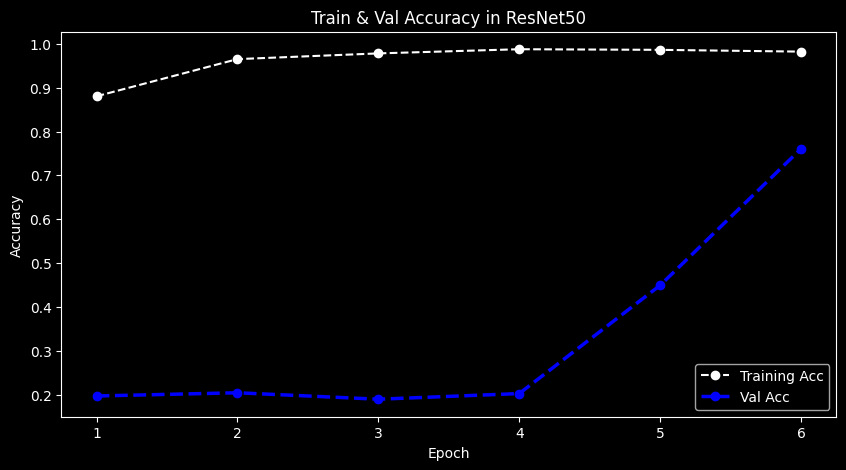

In [46]:
show_accuracy(Train_acc=Res50_model.history['accuracy'] , Val_acc=Res50_model.history['val_accuracy'] , epoch_num= range(1,7,1) , model='ResNet50')


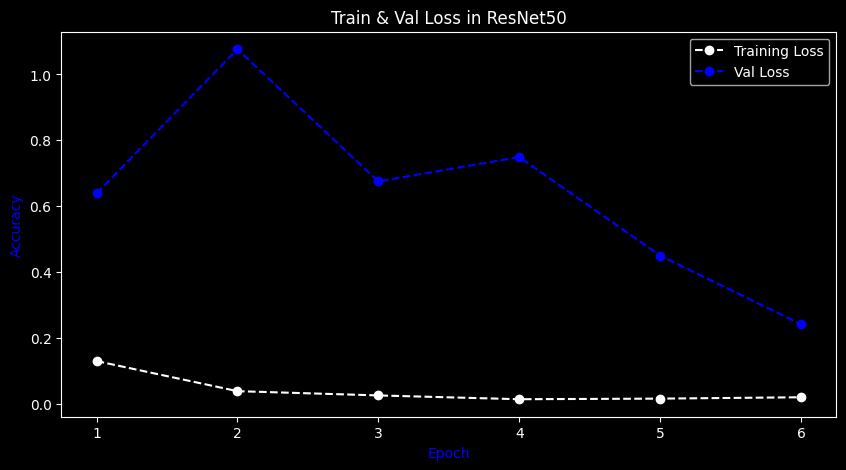

In [47]:
show_loss(Train_loss=Res50_model.history['loss'] , Val_loss=Res50_model.history['val_loss'] , epoch_num=range(1,7,1) , model='ResNet50')

In [48]:
Model_Resnet50.evaluate(Test_loader)#Evaluate the model 

17/17 ━━━━━━━━━━━━━━━━━━━━ 5s 321ms/step - accuracy: 0.7426 - loss: 0.2667


[0.27235695719718933, 0.7397388219833374]

In [49]:
Model_Resnet50.save('ResNet50.h5')#saving the Xception model

# Inceptionv3

In [50]:
Inceptionv3 = keras.applications.inception_v3.InceptionV3(include_top=False , weights='imagenet')
X = Inceptionv3.output
X = GlobalAveragePooling2D()(X)
X= Dense(1024 , activation='relu')(X)
prediction= Dense(5 , activation='softmax')(X)
Model_Inceptionv3 = Model(inputs = Inceptionv3.inputs , outputs = prediction )
Model_Inceptionv3.summary()

87910968/87910968 ━━━━━━━━━━━━━━━━━━━━ 3s 0us/step


Model: "functional_5"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_2       │ (None, None,      │          0 │ -                 │
│ (InputLayer)        │ None, 3)          │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d (Conv2D)     │ (None, None,      │        864 │ input_layer_2[0]… │
│                     │ None, 32)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalization │ (None, None,      │         96 │ conv2d[0][0]      │
│ (BatchNormalizatio… │ None, 32)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation          │ (None, None,      │          0 │ batch_normalizat… │
│ (Activation)        │ None, 32)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_1 (Conv2D)   │ (None, None,      │      9,216 │ activation[0][0]  │
│                     │ None, 32)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, None,      │         96 │ conv2d_1[0][0]    │
│ (BatchNormalizatio… │ None, 32)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_1        │ (None, None,      │          0 │ batch_normalizat… │
│ (Activation)        │ None, 32)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_2 (Conv2D)   │ (None, None,      │     18,432 │ activation_1[0][… │
│                     │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, None,      │        192 │ conv2d_2[0][0]    │
│ (BatchNormalizatio… │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_2        │ (None, None,      │          0 │ batch_normalizat… │
│ (Activation)        │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d       │ (None, None,      │          0 │ activation_2[0][… │
│ (MaxPooling2D)      │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_3 (Conv2D)   │ (None, None,      │      5,120 │ max_pooling2d[0]… │
│                     │ None, 80)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, None,      │        240 │ conv2d_3[0][0]    │
│ (BatchNormalizatio… │ None, 80)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_3        │ (None, None,      │          0 │ batch_normalizat… │
│ (Activation)        │ None, 80)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_4 (Conv2D)   │ (None, None,      │    138,240 │ activation_3[0][… │
│                     │ None, 192)        │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, None,      │        576 │ conv2d_4[0][0]    │
│ (BatchNormalizatio… │ None, 192)        │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_4        │ (None, None,      │          0 │ batch_normalizat

 Total params: 23,906,085 (91.19 MB)

 Trainable params: 23,871,653 (91.06 MB)

 Non-trainable params: 34,432 (134.50 KB)

In [51]:
tf.keras.utils.plot_model(
    Model_Inceptionv3,
    to_file='Inceptionv3_model.png',
    show_shapes=True,
    show_dtype=False,
    show_layer_names=True,
    show_layer_activations=True,
    dpi=80
)

In [52]:
Model_Inceptionv3.compile(loss=BinaryCrossentropy(),
            optimizer=Adam(learning_rate=0.001), metrics=['accuracy'])

In [53]:
IncV3_model = Model_Inceptionv3.fit(Train_loader, epochs=6, validation_data=Valid_loader)

Epoch 1/6


2024-11-27 07:07:47.110179: E external/local_xla/xla/service/slow_operation_alarm.cc:65] Trying algorithm eng0{} for conv (f32[192,80,3,3]{3,2,1,0}, u8[0]{0}) custom-call(f32[64,80,58,58]{3,2,1,0}, f32[64,192,56,56]{3,2,1,0}), window={size=3x3}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convBackwardFilter", backend_config={"operation_queue_id":"0","wait_on_operation_queues":[],"cudnn_conv_backend_config":{"conv_result_scale":1,"activation_mode":"kNone","side_input_scale":0,"leakyrelu_alpha":0}} is taking a while...
2024-11-27 07:07:47.176582: E external/local_xla/xla/service/slow_operation_alarm.cc:133] The operation took 1.066602222s
Trying algorithm eng0{} for conv (f32[192,80,3,3]{3,2,1,0}, u8[0]{0}) custom-call(f32[64,80,58,58]{3,2,1,0}, f32[64,192,56,56]{3,2,1,0}), window={size=3x3}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convBackwardFilter", backend_config={"operation_queue_id":"0","wait_on_operation_queues":[],"cudnn_conv_backend_config":{"conv_res

143/143 ━━━━━━━━━━━━━━━━━━━━ 155s 592ms/step - accuracy: 0.7409 - loss: 0.2473 - val_accuracy: 0.4696 - val_loss: 2.5372
Epoch 2/6
143/143 ━━━━━━━━━━━━━━━━━━━━ 43s 287ms/step - accuracy: 0.9665 - loss: 0.0382 - val_accuracy: 0.9576 - val_loss: 0.0616
Epoch 3/6
143/143 ━━━━━━━━━━━━━━━━━━━━ 43s 286ms/step - accuracy: 0.9767 - loss: 0.0245 - val_accuracy: 0.9484 - val_loss: 0.0659
Epoch 4/6
143/143 ━━━━━━━━━━━━━━━━━━━━ 43s 284ms/step - accuracy: 0.9798 - loss: 0.0213 - val_accuracy: 0.9853 - val_loss: 0.0185
Epoch 5/6
143/143 ━━━━━━━━━━━━━━━━━━━━ 43s 284ms/step - accuracy: 0.9841 - loss: 0.0149 - val_accuracy: 0.8527 - val_loss: 0.2048
Epoch 6/6
143/143 ━━━━━━━━━━━━━━━━━━━━ 43s 286ms/step - accuracy: 0.9777 - loss: 0.0219 - val_accuracy: 0.8564 - val_loss: 0.2716


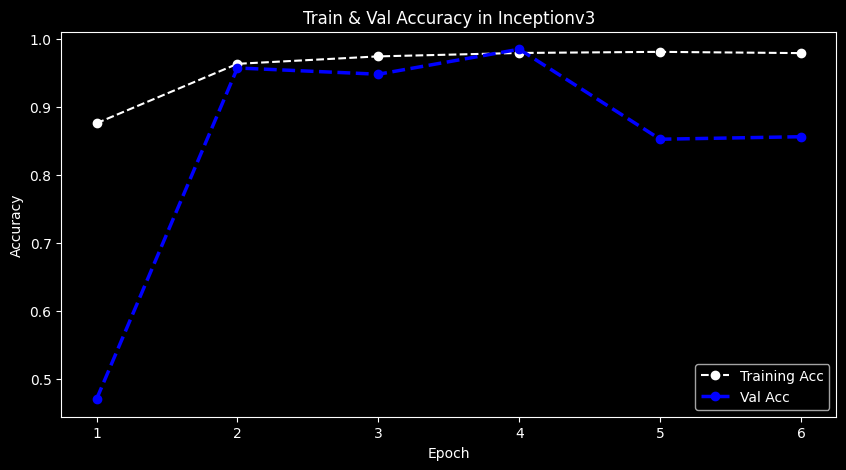

In [54]:

show_accuracy(Train_acc=IncV3_model.history['accuracy'] , Val_acc=IncV3_model.history['val_accuracy'] , epoch_num= range(1,7,1) , model='Inceptionv3')

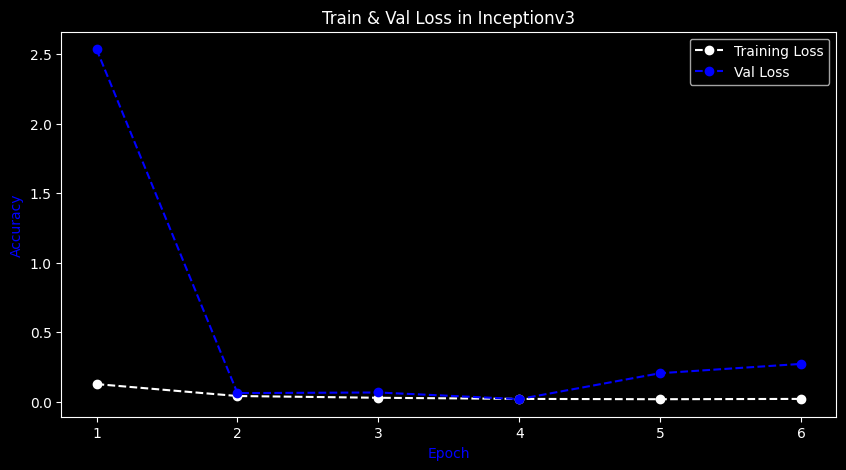

In [55]:


show_loss(Train_loss=IncV3_model.history['loss'] , Val_loss=IncV3_model.history['val_loss'] , epoch_num=range(1,7,1) , model='Inceptionv3')

In [56]:
Model_Inceptionv3.evaluate(Test_loader)#Evaluate the model 

17/17 ━━━━━━━━━━━━━━━━━━━━ 6s 374ms/step - accuracy: 0.8901 - loss: 0.2001


[0.21841493248939514, 0.888059675693512]

In [57]:
Model_Inceptionv3.save('Inceptionv3.h5')#saving the Xception model

# Xception

In [58]:
Xception = keras.applications.xception.Xception(include_top=False , weights='imagenet')
x=Xception.output
x = GlobalAveragePooling2D()(x)
x = Dense(1024 , activation='relu')(x)
Xception_prediction = Dense(5 , activation='softmax')(x)
Model_Xception = Model(inputs = Xception.inputs , outputs =Xception_prediction)
Model_Xception.summary()

83683744/83683744 ━━━━━━━━━━━━━━━━━━━━ 3s 0us/step


Model: "functional_7"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_3       │ (None, None,      │          0 │ -                 │
│ (InputLayer)        │ None, 3)          │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_conv1        │ (None, None,      │        864 │ input_layer_3[0]… │
│ (Conv2D)            │ None, 32)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_conv1_bn     │ (None, None,      │        128 │ block1_conv1[0][… │
│ (BatchNormalizatio… │ None, 32)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_conv1_act    │ (None, None,      │          0 │ block1_conv1_bn[… │
│ (Activation)        │ None, 32)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_conv2        │ (None, None,      │     18,432 │ block1_conv1_act… │
│ (Conv2D)            │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_conv2_bn     │ (None, None,      │        256 │ block1_conv2[0][… │
│ (BatchNormalizatio… │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_conv2_act    │ (None, None,      │          0 │ block1_conv2_bn[… │
│ (Activation)        │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block2_sepconv1     │ (None, None,      │      8,768 │ block1_conv2_act… │
│ (SeparableConv2D)   │ None, 128)        │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block2_sepconv1_bn  │ (None, None,      │        512 │ block2_sepconv1[… │
│ (BatchNormalizatio… │ None, 128)        │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block2_sepconv2_act │ (None, None,      │          0 │ block2_sepconv1_… │
│ (Activation)        │ None, 128)        │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block2_sepconv2     │ (None, None,      │     17,536 │ block2_sepconv2_… │
│ (SeparableConv2D)   │ None, 128)        │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block2_sepconv2_bn  │ (None, None,      │        512 │ block2_sepconv2[… │
│ (BatchNormalizatio… │ None, 128)        │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_94 (Conv2D)  │ (None, None,      │      8,192 │ block1_conv2_act… │
│                     │ None, 128)        │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block2_pool         │ (None, None,      │          0 │ block2_sepconv2_… │
│ (MaxPooling2D)      │ None, 128)        │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, None,      │        512 │ conv2d_94[0][0]   │
│ (BatchNormalizatio… │ None, 128)        │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add (Add)           │ (None, None,      │          0 │ block2_pool[0][0… │
│                     │ None, 128)        │            │ batch_normalizat… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block3_sepconv1_act │ (None, None,      │          0 │ add[0][0]       

 Total params: 22,964,781 (87.60 MB)

 Trainable params: 22,910,253 (87.40 MB)

 Non-trainable params: 54,528 (213.00 KB)

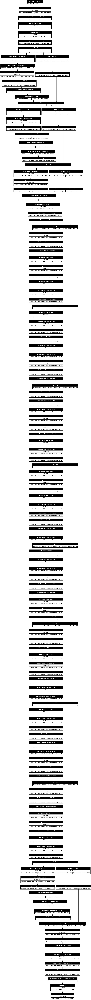

In [59]:
tf.keras.utils.plot_model(
    Model_Xception,
    to_file='Xception_model.png',
    show_shapes=True,
    show_dtype=False,
    show_layer_names=True,
    show_layer_activations=True,
    dpi=80
)

In [60]:
Model_Xception.compile(loss=BinaryCrossentropy(),
            optimizer=Adam(learning_rate=0.001), metrics=['accuracy'])

In [61]:
X_model = Model_Xception.fit(Train_loader, epochs=6, validation_data=Valid_loader)

Epoch 1/6


2024-11-27 07:14:04.207333: E external/local_xla/xla/service/slow_operation_alarm.cc:65] Trying algorithm eng0{} for conv (f32[728,728,1,1]{3,2,1,0}, u8[0]{0}) custom-call(f32[64,728,30,30]{3,2,1,0}, f32[64,728,30,30]{3,2,1,0}), window={size=1x1}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convBackwardFilter", backend_config={"operation_queue_id":"0","wait_on_operation_queues":[],"cudnn_conv_backend_config":{"conv_result_scale":1,"activation_mode":"kNone","side_input_scale":0,"leakyrelu_alpha":0}} is taking a while...
2024-11-27 07:14:04.376743: E external/local_xla/xla/service/slow_operation_alarm.cc:133] The operation took 1.169588991s
Trying algorithm eng0{} for conv (f32[728,728,1,1]{3,2,1,0}, u8[0]{0}) custom-call(f32[64,728,30,30]{3,2,1,0}, f32[64,728,30,30]{3,2,1,0}), window={size=1x1}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convBackwardFilter", backend_config={"operation_queue_id":"0","wait_on_operation_queues":[],"cudnn_conv_backend_config":{"conv

143/143 ━━━━━━━━━━━━━━━━━━━━ 173s 827ms/step - accuracy: 0.7501 - loss: 0.2257 - val_accuracy: 0.9282 - val_loss: 0.1844
Epoch 2/6
143/143 ━━━━━━━━━━━━━━━━━━━━ 82s 564ms/step - accuracy: 0.9752 - loss: 0.0289 - val_accuracy: 0.9540 - val_loss: 0.0532
Epoch 3/6
143/143 ━━━━━━━━━━━━━━━━━━━━ 83s 566ms/step - accuracy: 0.9823 - loss: 0.0179 - val_accuracy: 0.9484 - val_loss: 0.0622
Epoch 4/6
143/143 ━━━━━━━━━━━━━━━━━━━━ 83s 565ms/step - accuracy: 0.9828 - loss: 0.0151 - val_accuracy: 0.9705 - val_loss: 0.0586
Epoch 5/6
143/143 ━━━━━━━━━━━━━━━━━━━━ 83s 565ms/step - accuracy: 0.9842 - loss: 0.0175 - val_accuracy: 0.9742 - val_loss: 0.0278
Epoch 6/6
143/143 ━━━━━━━━━━━━━━━━━━━━ 83s 566ms/step - accuracy: 0.9861 - loss: 0.0170 - val_accuracy: 0.9761 - val_loss: 0.0631


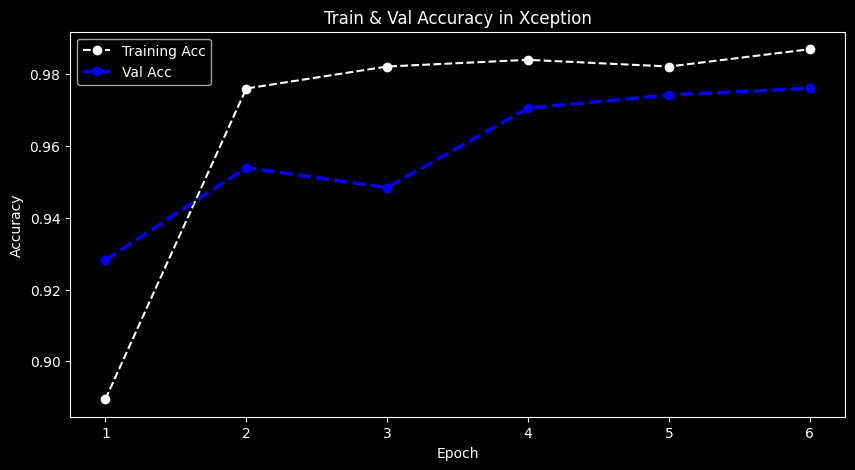

In [62]:
show_accuracy(Train_acc=X_model.history['accuracy'] , Val_acc=X_model.history['val_accuracy'] , epoch_num= range(1,7,1) , model='Xception')


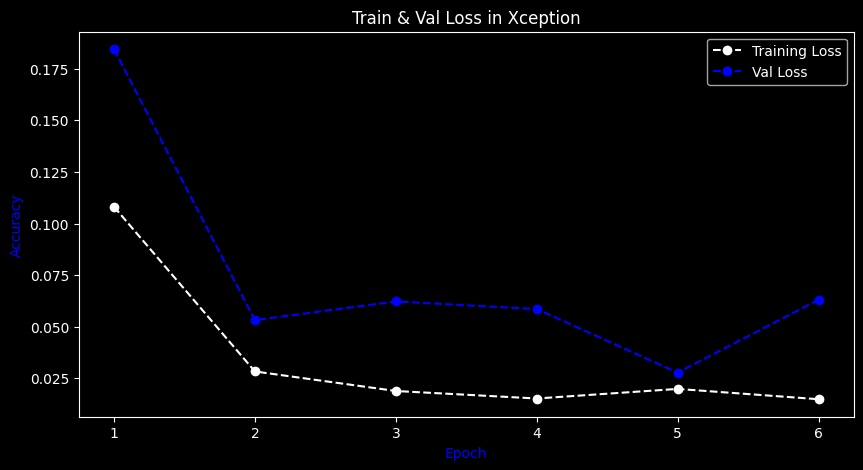

In [63]:
show_loss(Train_loss=X_model.history['loss'] , Val_loss=X_model.history['val_loss'] , epoch_num=range(1,7,1) , model='Xception')

In [64]:
Model_Xception.evaluate(Test_loader)#Evaluate the model 

17/17 ━━━━━━━━━━━━━━━━━━━━ 5s 302ms/step - accuracy: 0.9785 - loss: 0.0299


[0.03724103048443794, 0.9757462739944458]

In [65]:
Model_Xception.save('XceptionModel.h5')#saving the Xception model


In [66]:
tf.keras.models.load_model('XceptionModel.h5')# Loading Xception model from the address we have already saved that 

<Functional name=functional_7, built=True>

# Models Comparison

In [67]:
def show_all_models(kind , rang , titl , yl):
    
    plt.style.use('dark_background')
    
    plt.figure(figsize=(10,5), dpi=100)

    plt.plot(rang, VGG16_model.history[kind], '--bo',color= 'white',
             linewidth = '2.5', label='line with marker')

    plt.plot(rang, Res50_model.history[kind], '--bo',color= 'red',
             linewidth = '2.5', label='line with marker')

    plt.plot(rang, IncV3_model.history[kind], '--bo',color= 'purple',
             linewidth = '2.5', label='line with marker')

    plt.plot(rang, X_model.history[kind], '--bo',color= 'blue',
             linewidth = '2.5', label='line with marker')

    plt.legend(['VGG16', 'ResNet50','Inceptionv3' , 'Xception'])
    plt.title(f'{titl} comparison in 4 models ')
    plt.xlabel('Epoch' , c='blue')
    plt.ylabel(f'{yl}' , c='blue')
    plt.xticks(rang)
    plt.show()

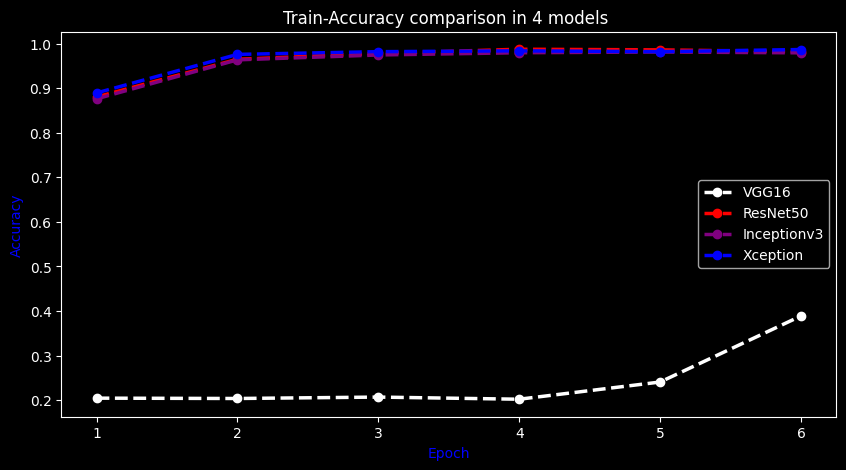

In [68]:
show_all_models(kind='accuracy' , rang = range(1,7,1) , titl='Train-Accuracy' , yl='Accuracy')

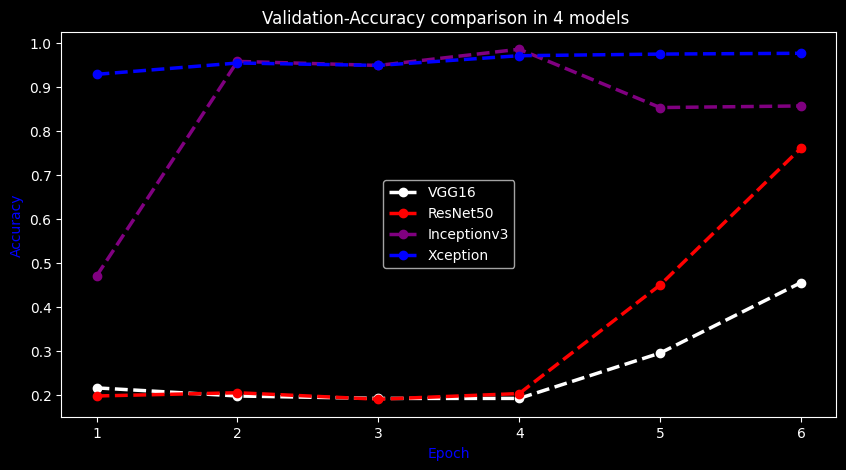

In [69]:
show_all_models(kind='val_accuracy' , rang = range(1,7,1) , titl='Validation-Accuracy' , yl='Accuracy')

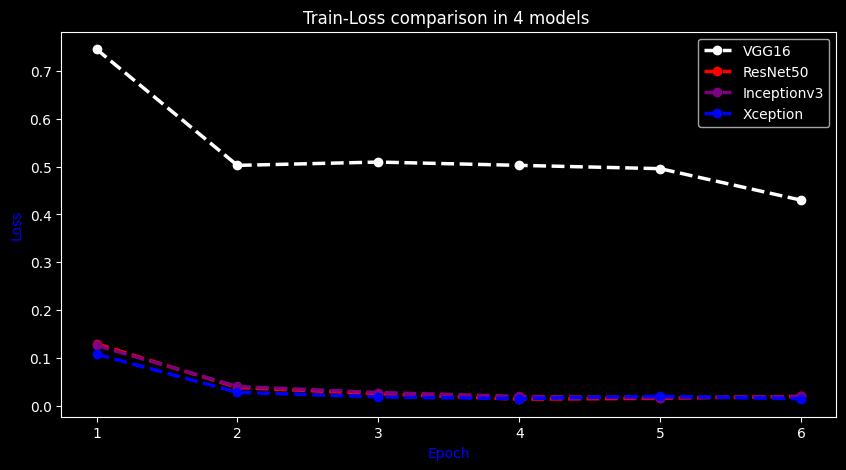

In [70]:
show_all_models(kind='loss' , rang = range(1,7,1) , titl='Train-Loss' , yl='Loss')

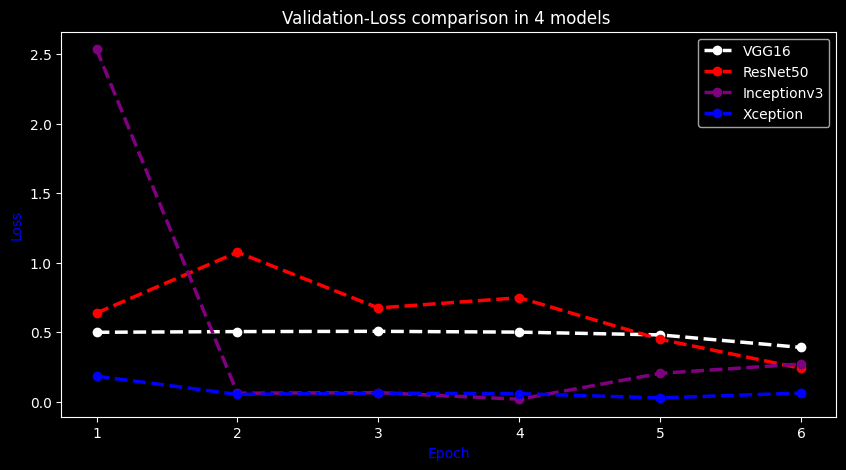

In [71]:
show_all_models(kind='val_loss' , rang = range(1,7,1) , titl='Validation-Loss' , yl='Loss')

# Xception Model Prediction

2/2 ━━━━━━━━━━━━━━━━━━━━ 6s 53ms/step


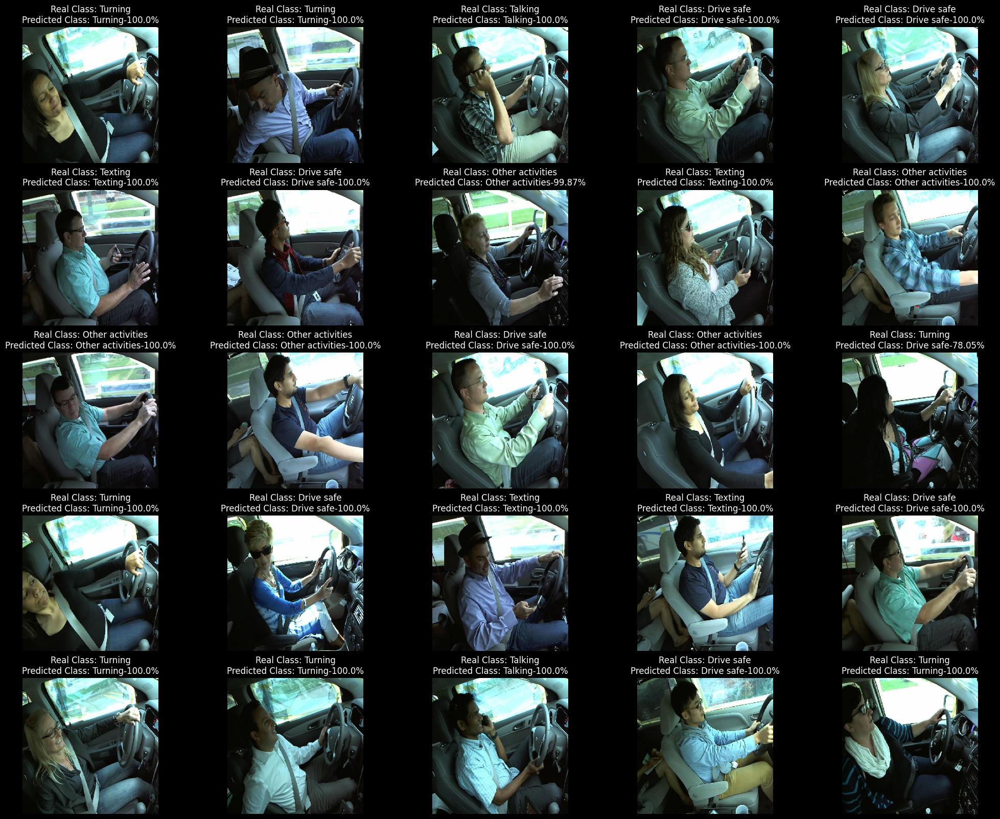

In [72]:
Test_loader.reset()
images, labels = next(Test_loader)
predictions = Model_Xception.predict(images)
predicted_classes = np.argmax(predictions, axis=1)
plt.figure(figsize=(25, 20))
for i in range(25):
    plt.subplot(5, 5, i+1)
    plt.imshow(images[i])
    plt.axis('off')
    plt.title(f"Real Class: {Driver_behaviour_classes[np.argmax(labels[i])]}\nPredicted Class: {Driver_behaviour_classes[predicted_classes[i]]}-{round(100 * np.max(predictions[i]),2)}%")
    
plt.show()  

# Models in Dataframe

In [73]:
CNN_models = ['VGG16' , 'ResNet50' , 'Inceptionv3' , 'Xception']
Models_train_acc = [VGG16_model.history['accuracy'],Res50_model.history['accuracy'],IncV3_model.history['accuracy'],X_model.history['accuracy']]
Models_train_loss = [VGG16_model.history['loss'],Res50_model.history['loss'],IncV3_model.history['loss'],X_model.history['loss']]
Models_validation_acc = [VGG16_model.history['val_accuracy'],Res50_model.history['val_accuracy'],IncV3_model.history['val_accuracy'], X_model.history['val_accuracy']]
Models_validation_loss = [VGG16_model.history['val_loss'],Res50_model.history['val_loss'],IncV3_model.history['val_loss'], X_model.history['val_loss']]

In [74]:
Compare_models = pd.DataFrame({'CNN Model':CNN_models,
            'Train accuracy':Models_train_acc , 
            'Train loss': Models_train_loss  , 
            'Validation accuracy' :Models_validation_acc ,
            'Validation loss' :Models_validation_loss ,
             })

In [75]:
Compare_models

,CNN Model,Train accuracy,Train loss,Validation accuracy,Validation loss
0,VGG16,"[0.20424693822860718, 0.20348073542118073, 0.2...","[0.7452384829521179, 0.5025361180305481, 0.509...","[0.2154696136713028, 0.19705340266227722, 0.19...","[0.5001013875007629, 0.5051588416099548, 0.507..."
1,ResNet50,"[0.880363404750824, 0.9650831818580627, 0.9781...","[0.1297939121723175, 0.03841405361890793, 0.02...","[0.19705340266227722, 0.20441989600658417, 0.1...","[0.6385813355445862, 1.0764104127883911, 0.675..."
2,Inceptionv3,"[0.8762040138244629, 0.9637696743011475, 0.974...","[0.12636646628379822, 0.04052603617310524, 0.0...","[0.469613254070282, 0.9576427340507507, 0.9484...","[2.5371792316436768, 0.06164132058620453, 0.06..."
3,Xception,"[0.889448344707489, 0.9760289192199707, 0.9821...","[0.10810508579015732, 0.028346102684736252, 0....","[0.9281768202781677, 0.9539594650268555, 0.948...","[0.18442471325397491, 0.05321492254734039, 0.0..."


In [78]:
import joblib

In [79]:
joblib.dump(Model_Xception, 'Xception_model')

['Xception_model']

In [81]:
m = joblib.load('Xception_model')

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


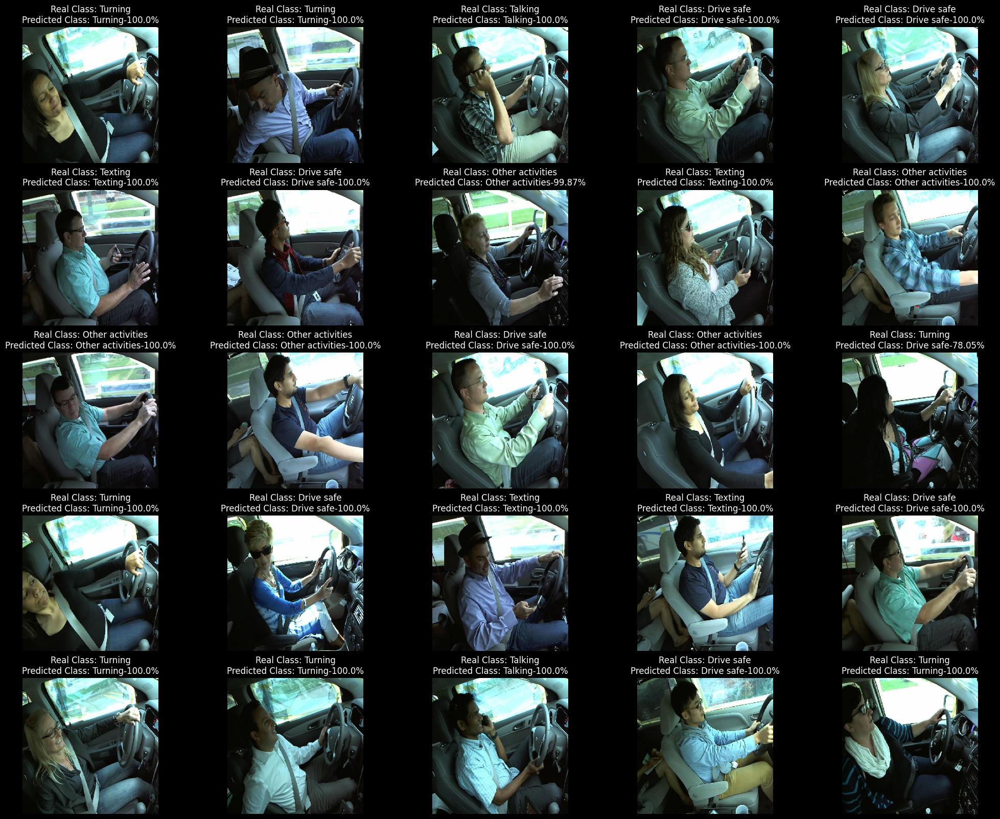

In [84]:
predictions = m.predict(images)
predicted_classes = np.argmax(predictions, axis=1)
plt.figure(figsize=(25, 20))
for i in range(25):
    plt.subplot(5, 5, i+1)
    plt.imshow(images[i])
    plt.axis('off')
    plt.title(f"Real Class: {Driver_behaviour_classes[np.argmax(labels[i])]}\nPredicted Class: {Driver_behaviour_classes[predicted_classes[i]]}-{round(100 * np.max(predictions[i]),2)}%")
    
plt.show()  